In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import Markdown

%matplotlib inline

from sklearn.datasets import load_breast_cancer



data = load_breast_cancer(as_frame=True)

# Read the DataFrame, first using the feature data
df = pd.DataFrame(data.data, columns=data.feature_names)
# Add a target column, and fill it with the target data
df['diagnosis'] = data.target

## Data visualization
### Dataframe .describe()

In [48]:
df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,diagnosis
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


### Frequency of the diagnosis target attribute

Benign count : 	 212
Malign count : 	 357


<AxesSubplot:ylabel='Frequency'>

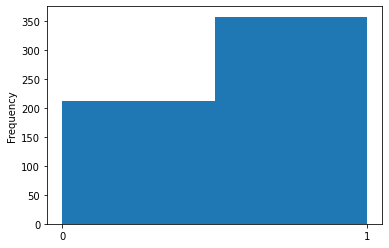

In [49]:
benign_count = df.diagnosis[df['diagnosis'] == 0].count()
malign_count = df.diagnosis[df['diagnosis'] == 1].count()

print(f'Benign count : \t {benign_count}')
print(f'Malign count : \t {malign_count}')

df.diagnosis.plot.hist(bins=2, xticks=[0, 1])

### All the dataset's attributes

In [50]:
display(
    Markdown('### Columns of the dataset:'),
    #df.columns,
    ', '.join([name for name in df.columns]),
    Markdown("""### We can differenciate 3 types of attributes ('diagnosis' aside) : mean, error, and worst"""),
)

### Columns of the dataset:

'mean radius, mean texture, mean perimeter, mean area, mean smoothness, mean compactness, mean concavity, mean concave points, mean symmetry, mean fractal dimension, radius error, texture error, perimeter error, area error, smoothness error, compactness error, concavity error, concave points error, symmetry error, fractal dimension error, worst radius, worst texture, worst perimeter, worst area, worst smoothness, worst compactness, worst concavity, worst concave points, worst symmetry, worst fractal dimension, diagnosis'

### We can differenciate 3 types of attributes ('diagnosis' aside) : mean, error, and worst

### Visualizing the 3 types of attributes using sns.pairplot()

In [51]:
_mean_columns = ['diagnosis'] + [col for col in df.columns if 'mean' in col]
_error_columns = ['diagnosis'] + [col for col in df.columns if 'error' in col]
_worst_columns = ['diagnosis'] + [col for col in df.columns if 'worst' in col]

# print(f'mean columns:\n {str(_mean_columns)} \n')
# print(f'error columns:\n {str(_error_columns)} \n')
# print(f'worst columns:\n {str(_worst_columns)} \n')

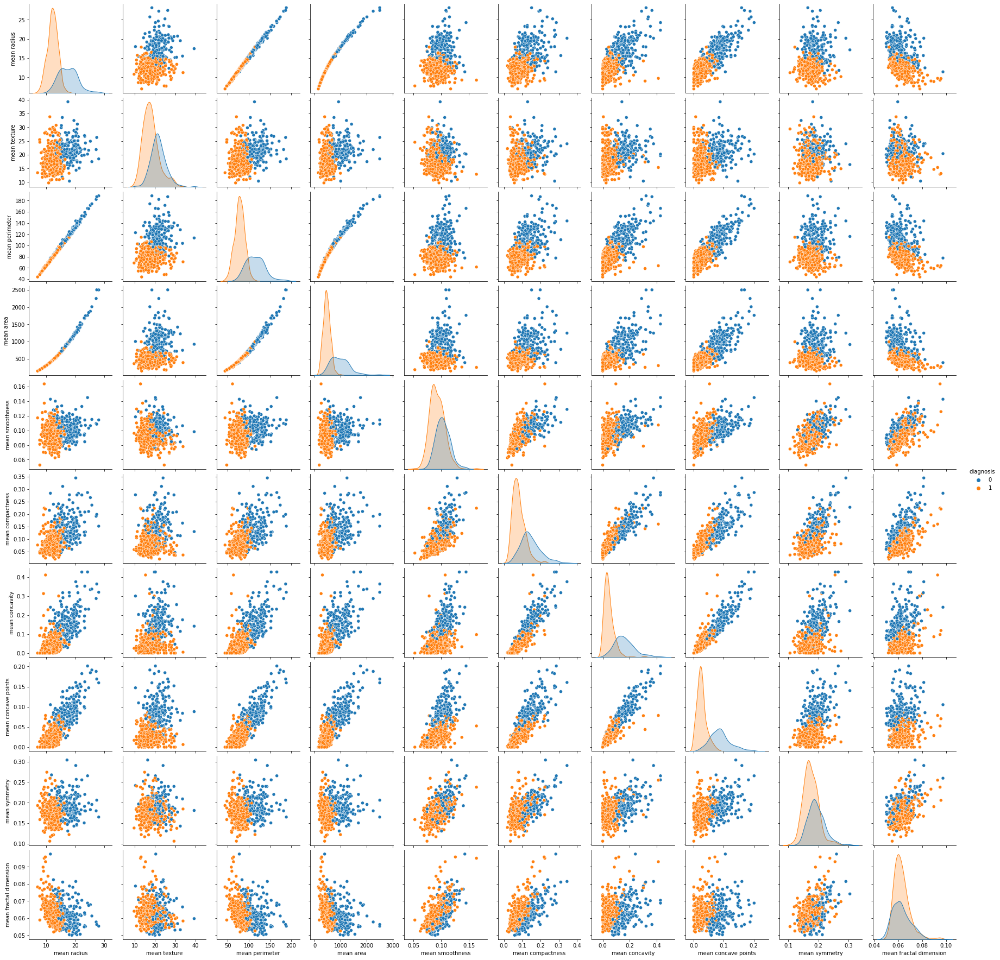

In [52]:
sns.pairplot(df[_mean_columns], hue='diagnosis')

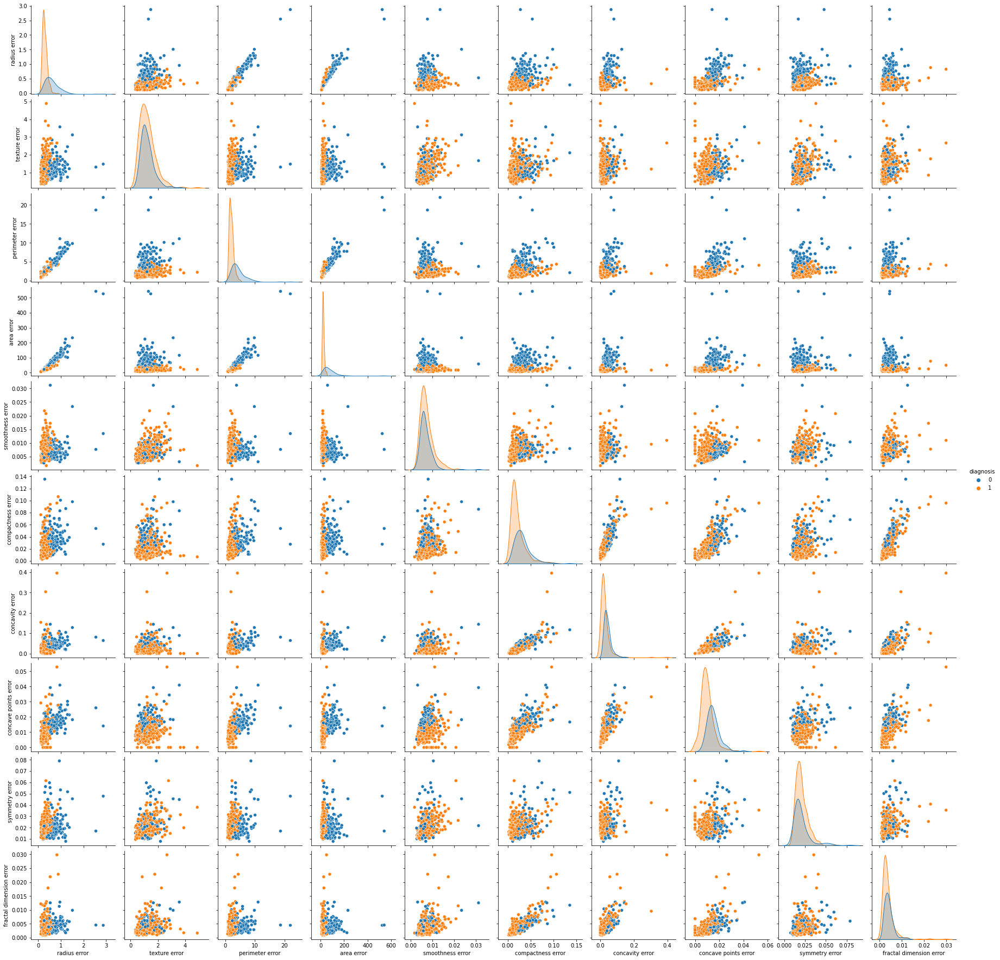

In [53]:
sns.pairplot(df[_error_columns], hue='diagnosis')

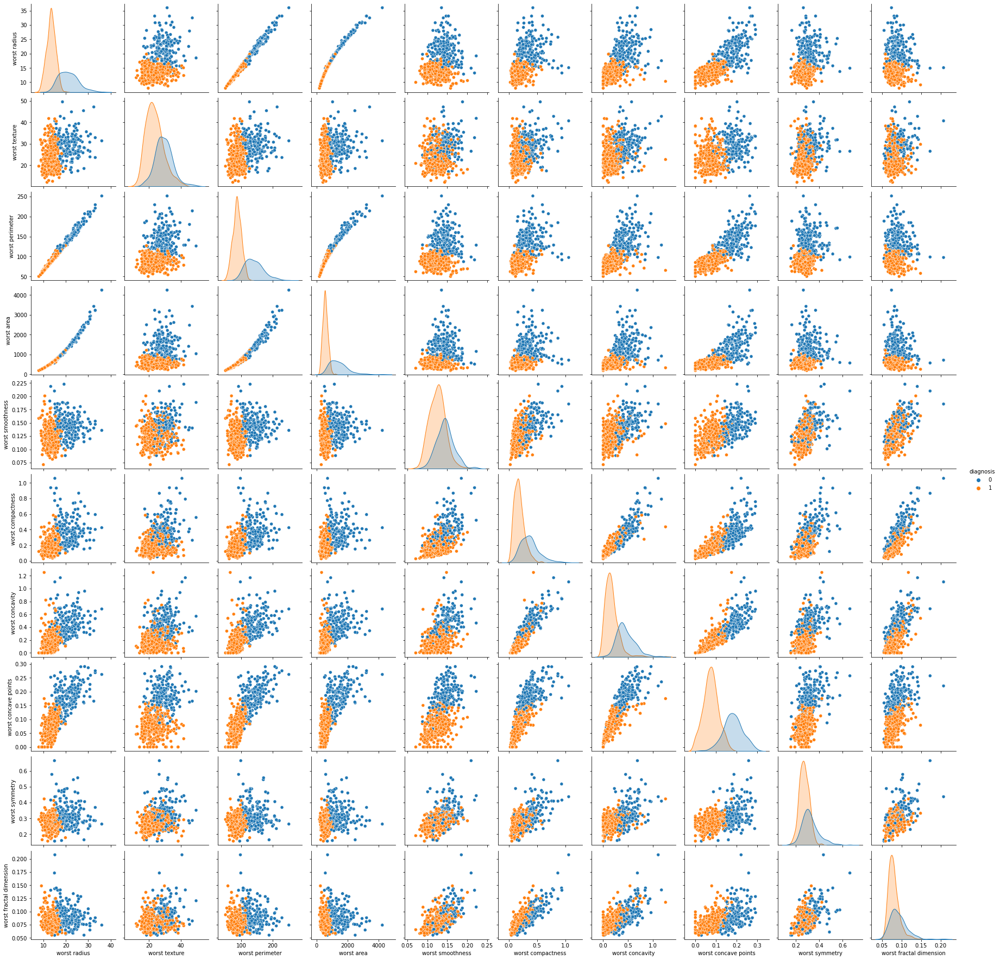

In [54]:
sns.pairplot(df[_worst_columns], hue='diagnosis')

### Check for missing values

In [55]:
df.isnull().any()

mean radius                False
mean texture               False
mean perimeter             False
mean area                  False
mean smoothness            False
mean compactness           False
mean concavity             False
mean concave points        False
mean symmetry              False
mean fractal dimension     False
radius error               False
texture error              False
perimeter error            False
area error                 False
smoothness error           False
compactness error          False
concavity error            False
concave points error       False
symmetry error             False
fractal dimension error    False
worst radius               False
worst texture              False
worst perimeter            False
worst area                 False
worst smoothness           False
worst compactness          False
worst concavity            False
worst concave points       False
worst symmetry             False
worst fractal dimension    False
diagnosis 

### Fiding correlations between attributes using a heatmap

<AxesSubplot:>

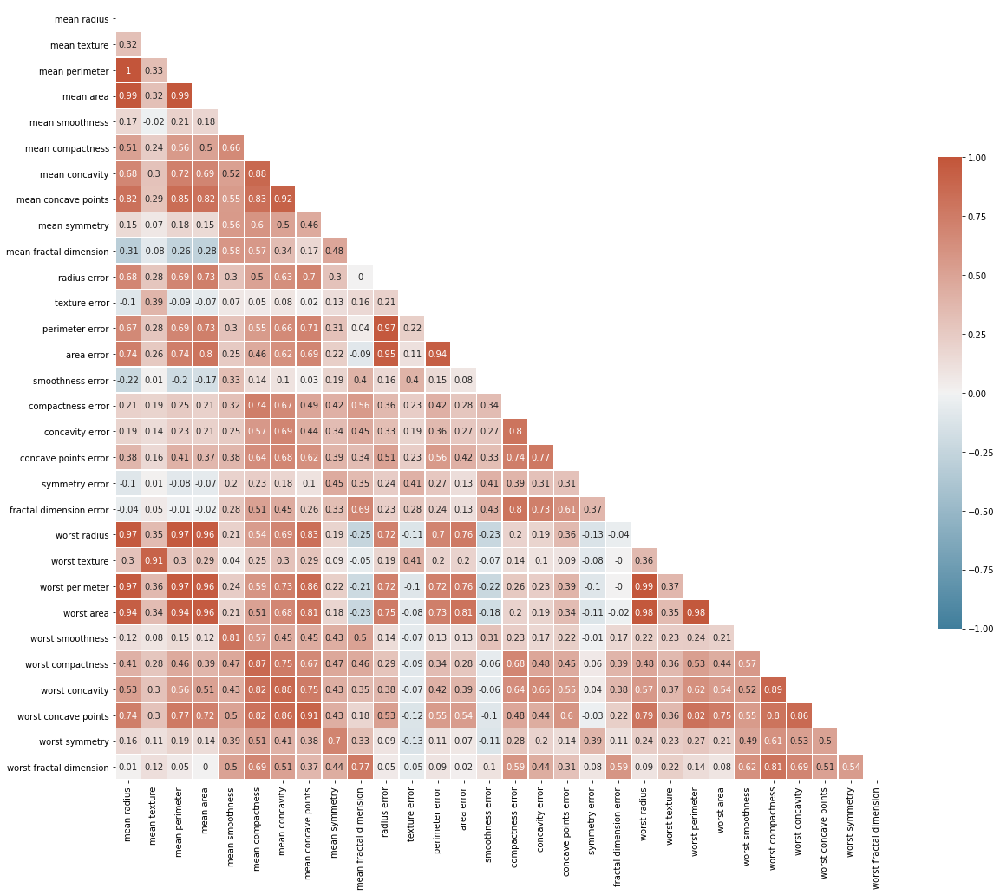

In [56]:
# from https://seaborn.pydata.org/examples/many_pairwise_correlations.html

# Compute the correlation matrix
corr = df.loc[:, df.columns != 'diagnosis'].corr().round(2)

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)


In [57]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import mean_absolute_error

import matplotlib.pyplot as plt
import seaborn as sns


## Visualization of the transformed data

<AxesSubplot:xlabel='0', ylabel='1'>

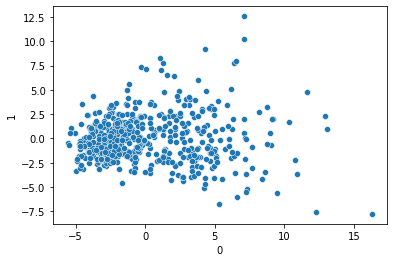

In [58]:
X_std = StandardScaler().fit_transform(
    # df
    df.loc[:, df.columns != 'diagnosis'] # we don't use the diagnosis target feature
)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_std)
X_pca = pd.DataFrame(X_pca)

sns.scatterplot(X_pca[0], X_pca[1])

In [59]:
## Clustering on the transformed data and evaluation of the results

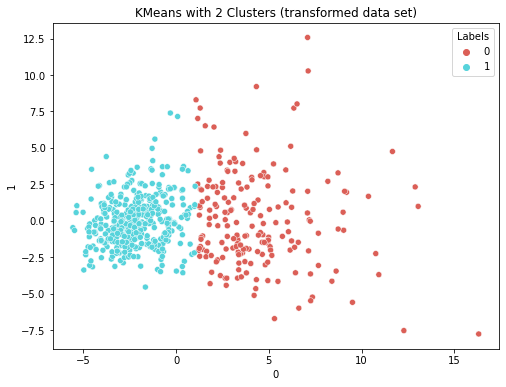

### Using KMeans clustering on the transformed dataset, we obtain a **Mean Absolute Error** of 

 ## `0.0931`

In [60]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np


km = KMeans(n_clusters=2).fit(X_pca)

km_df = pd.DataFrame(X_pca)

km_df['Labels'] = km.labels_

plt.figure(figsize=(8, 6))
sns.scatterplot(km_df[0], km_df[1], hue=km_df['Labels'], 
                palette=sns.color_palette('hls', 2))
plt.title(f'KMeans with 2 Clusters (transformed data set)')
plt.show()

val_mae = mean_absolute_error(km_df['Labels'], df.diagnosis)
display(Markdown(f'### Using KMeans clustering on the transformed dataset, we obtain a **Mean Absolute Error** of \n\n ## `{val_mae:.4f}`'))


## Clustering on the original data and evaluation of the results

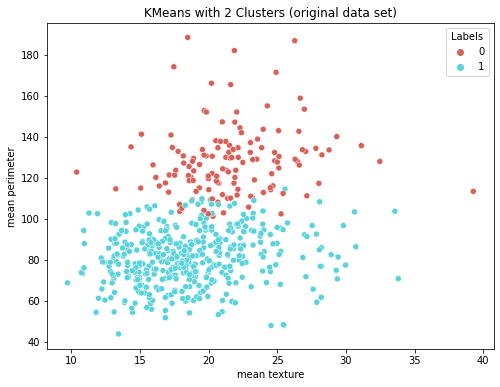

### Using KMeans clustering on the original dataset (without transformation), we obtain a **Mean Absolute Error** of 

 ## `0.1459`

In [61]:
km = KMeans(n_clusters=2).fit(df.loc[:, df.columns != 'diagnosis'])

df['Labels'] = km.labels_

plt.figure(figsize=(8, 6))
sns.scatterplot(df['mean texture'], df['mean perimeter'], hue=df['Labels'], 
                palette=sns.color_palette('hls', 2))
plt.title(f'KMeans with 2 Clusters (original data set)')
plt.show()

val_mae = mean_absolute_error(df['Labels'], df.diagnosis)
display(Markdown(f'### Using KMeans clustering on the original dataset (without transformation), we obtain a **Mean Absolute Error** of \n\n ## `{val_mae:.4f}`'))

## Comparision of the results

By looking of the MAE (Mean Absolute Error), we can see that transforming the data before clustering gives better results.

| Transformation before clustering ? &nbsp;&nbsp;&nbsp;&nbsp | MAE Value |
|:--:|:--:|
| Yes | 0.0931 |
| No | 0.1459 |